In [1]:
import keras
keras.__version__

'2.4.3'

# Visualize what convnets learn

- `Visualizing intermediate convnet outputs` ("intermediate activations"). This is useful to understand how successive convnet layers transform their input, and to get a first idea of the meaning of individual convnet filters.
- `Visualizing convnets filters`. This is useful to understand precisely what visual pattern or concept each filter in a convnet is receptive to.
- `Visualizing heatmaps of class activation` in an image. This is useful to understand which part of an image identified as belonging to a given class, and thus allows to localize objects in images.



## Visualizing intermediate activations
Visualizing intermediate activations consists in diplaying the feature maps that are output by various convolution and pooling layers in the network, given a certain input.

In [2]:
from keras.models import load_model

model = load_model('cats_and_dogs_small_2.h5')
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_4 (Conv2D)            (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 72, 72, 64)        18496     
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 36, 36, 64)        0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 34, 34, 128)       73856     
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 17, 17, 128)       0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 15, 15, 128)      

(1, 150, 150, 3)


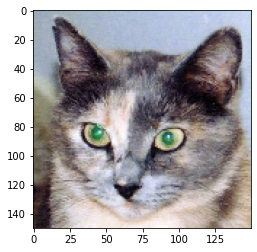

In [3]:
"""
This will be the input image we will use -- a picture of a cat, not part of images that the network was trained on.
"""
img_path = 'cats_and_dogs_small/test/cats/cat.1700.jpg'

# We preprocess the image into a 4D tensor
from keras.preprocessing import image
import numpy as np

img = image.load_img(img_path, target_size=(150, 150))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
# Remember that the model was trained on inputs
# that were preprocessed in the following way:
img_tensor /= 255.

# Its shape is (1, 150, 150, 3)
print(img_tensor.shape)

import matplotlib.pyplot as plt
plt.imshow(img_tensor[0])
plt.show()

In order to extract the feature maps we want to look at, we will create a Keras model that takes batches of images as input, and outputs the activations of all convolution and pooling layers. To do this, we will use the `Keras class Model`. A `Model` is instantiated using two arguments: an input tensor (or list of input tensors), and an output tensor (or list of output tensors). 

The resulting class is a `Keras model`, just like the `Sequential models` that you are familiar with, mapping the specified inputs to the specified outputs. What sets the Model class apart is that it allows for models with multiple outputs, unlike Sequential. For more information about the Model class, see Chapter 7, Section 1.


In [4]:
from tensorflow.keras import models

# Extracts the outputs of the top 8 layers:
layer_outputs = [layer.output for layer in model.layers[:8]]

# Creates a model that will return these outputs, given the model input:
activation_model = models.Model(inputs=model.input, outputs=layer_outputs)

In [5]:
# Because there are 8 layers in the network, the network should have 8 outputs.
# This will return a list of 8 Numpy arrays: one array per layer activation
activations = activation_model.predict(img_tensor)
len(activations)

8

(1, 148, 148, 32)


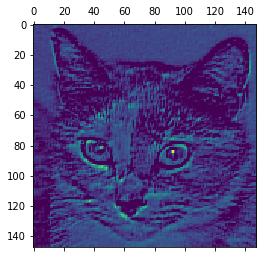

In [6]:
# The activation of first layer is a 148x148 feature map with 32 channels.
first_layers_activation = activations[0]
print(first_layers_activation.shape)

# Visualize the 3rd channel. 
plt.matshow(first_layers_activation[0,:,:,3], cmap='viridis')
plt.show()

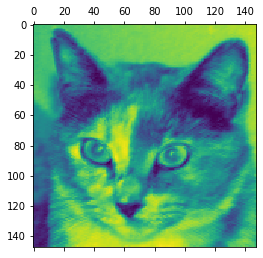

In [7]:
# Visualize the 30th channel
plt.matshow(first_layers_activation[0,:,:,30], cmap='viridis')
plt.show()

Let's plot a complete visualization of all the activations in the network.

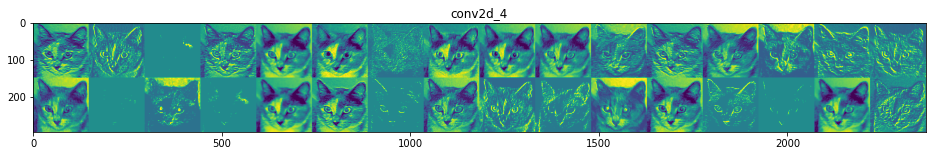

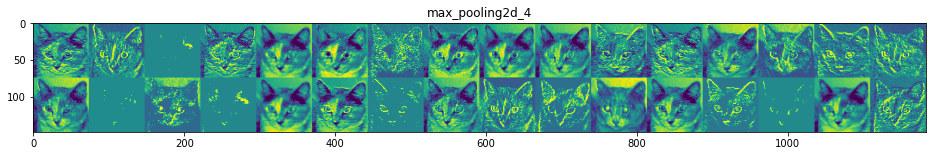

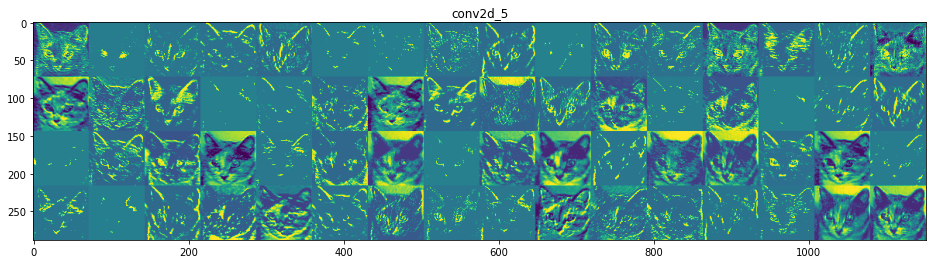

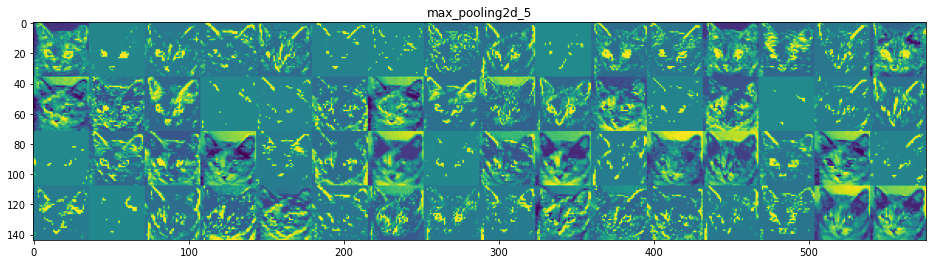

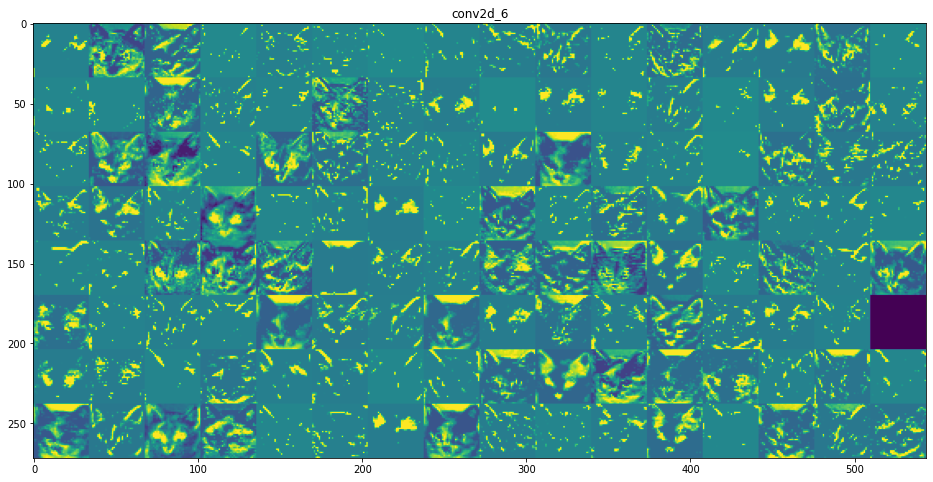

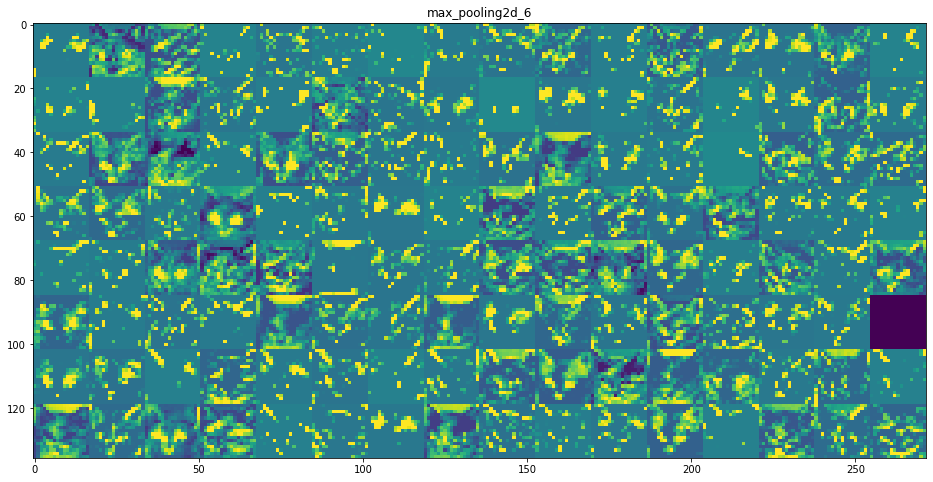

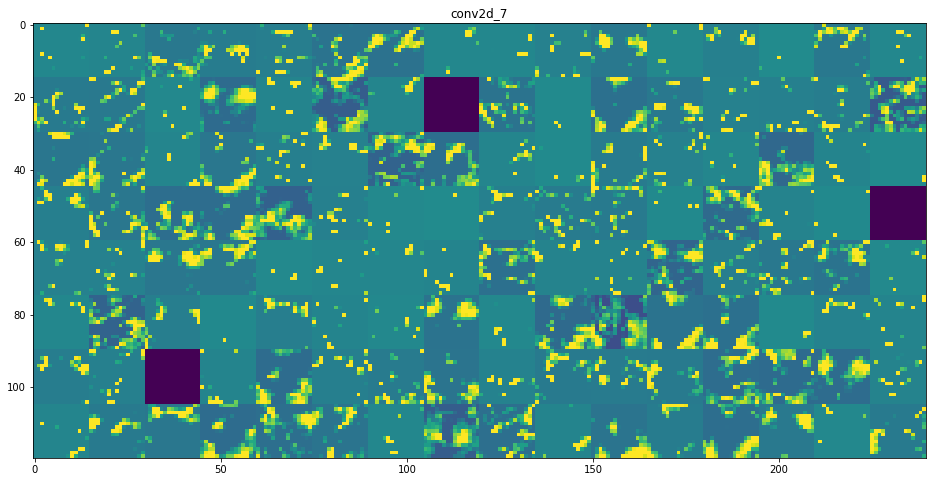

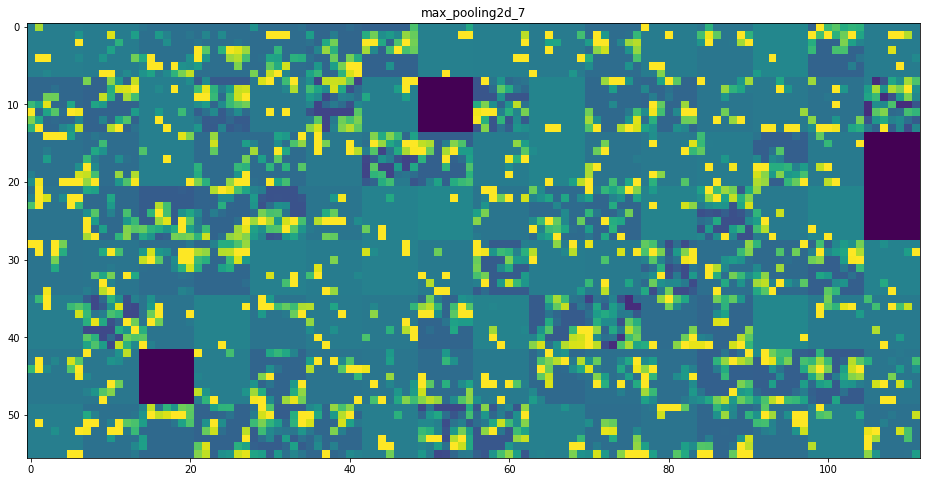

In [8]:
import keras

# These are the names of the layers, so can have them as part of our plot
layer_names = []
for layer in model.layers[:8]:
    layer_names.append(layer.name)

images_per_row = 16

# Now let's display our feature maps
for layer_name, layer_activation in zip(layer_names, activations):
    # This is the number of features in the feature map
    n_features = layer_activation.shape[-1]

    # The feature map has shape (1, size, size, n_features)
    size = layer_activation.shape[1]

    # We will tile the activation channels in this matrix
    n_cols = n_features // images_per_row
    display_grid = np.zeros((size * n_cols, images_per_row * size))

    # We'll tile each filter into this big horizontal grid
    for col in range(n_cols):
        for row in range(images_per_row):
            channel_image = layer_activation[0,
                                             :, :,
                                             col * images_per_row + row]
            # Post-process the feature to make it visually palatable
            channel_image -= channel_image.mean()
            channel_image /= channel_image.std()
            channel_image *= 64
            channel_image += 128
            channel_image = np.clip(channel_image, 0, 255).astype('uint8')
            display_grid[col * size : (col + 1) * size,
                         row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1],
                        scale * display_grid.shape[0]))
    plt.title(layer_name)
    plt.grid(False)
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
    
plt.show()

A few remarkable things to note here:

- The first layer acts as a collection of various edge detectors. At that stage, the activations are still retaining almost all of the information present in the initial picture.
- `As we go higher-up, the activations become increasingly abstract and less visually interpretable`. They start encoding higher-level concepts such as "cat ear" or "cat eye". Higher-up presentations carry increasingly less information about the visual contents of the image, and increasingly more information related to the class of the image.
- `The sparsity of the activations is increasing with the depth of the layer`: in the first layer, all filters are activated by the input image, but in the following layers more and more filters are blank. This means that the pattern encoded by the filter isn't found in the input image.

## Visualizaing convnet filters

Another easy thing to do to inspect the filters learned by convnets is to display the visual pattern that each filter is meant to respond to. This can be done with gradient ascent in input space: `applying gradient descent to the value of the input image of a convnet so as to maximize the response of a specific filter, starting from a blank input image`. The resulting input image would be one that the chosen filter is maximally responsive to.

In [30]:
from keras.applications import VGG16
from keras import backend as K

model = VGG16(weights='imagenet', include_top=False)

layer_name = 'block3_conv1'
filter_index = 0

layer_output = model.get_layer(layer_name).output
model.summary()

Model: "vgg16"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, None, None, 3)]   0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, None, None, 64)    1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, None, None, 64)    36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, None, None, 64)    0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, None, None, 128)   73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, None, None, 128)   147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, None, None, 128)   0     

In [32]:
# Define the size and produce a random grey image with some noise, then cast it to a tensor of float32
size = 150
img_tensor = np.random.random((1, size, size, 3)) * 20 + 128.
img_tensor = tf.Variable(tf.cast(img_tensor, tf.float32))

# Specify the convolution layer and the filter we want to connect to
conv_layer = model.get_layer("block3_conv1")
filter_index = 0
step_size = 1

# Create a connection between the input and the target layer
submodel = tf.keras.models.Model([model.inputs[0]], [conv_layer.output])

# In this case we run gradient ascent only once as an example
with tf.GradientTape() as tape:
    outputs = submodel(img_tensor)
    loss_value = tf.reduce_mean(outputs[:, :, :, filter_index])
    
# Get the gradients with tape.gradient
grads = tape.gradient(loss_value, img_tensor)

A non obvious trick to use to help the gradient descent process go smoothly is to normalize the gradient tensor by dividing it by its L2 norm (the square root ocf the average of the square of the values in the tensor). This ensures that the magnitude of the updates done to the input image is always within the same range.

After the normalization, we can perform the gradient ascent with assign_add on the initial variable. We should obtain a tensor of shape (1, size, size, 3)

In [34]:
normalized_grads = grads / (tf.sqrt(tf.reduce_mean(tf.square(grads))) + 1e-5) # Add a small costant at the end to avoid divisions by 0

img_tensor.assign_add(normalized_grads * step_size)
img_tensor.shape


TensorShape([1, 150, 150, 3])

In [35]:
def generate_pattern(layer_name, filter_index, size=150):
    img_tensor = np.random.random((1, size, size, 3)) * 20 + 128.
    img_tensor = tf.Variable(tf.cast(img_tensor, tf.float32))
    
    conv_layer = model.get_layer(layer_name)
    step_size = 1

    submodel = tf.keras.models.Model([model.inputs[0]], [conv_layer.output])

    # Run gradient ascent for 40 steps
    for _ in range(40):
        with tf.GradientTape() as tape:
            outputs = submodel(img_tensor)
            loss_value = tf.reduce_mean(outputs[:, :, :, filter_index])

        grads = tape.gradient(loss_value, img_tensor)
        normalized_grads = grads / (tf.sqrt(tf.reduce_mean(tf.square(grads))) + 1e-5)
        img_tensor.assign_add(normalized_grads * step_size)
    
    # Convert values input data to the valid range for imshow with RGB data ([0..255] for integers)
    img = img_tensor[0].numpy().astype(np.uint8) 
    
    return img

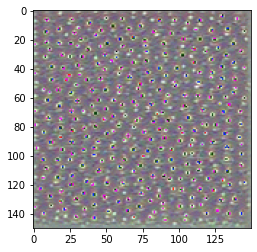

In [36]:
plt.imshow(generate_pattern('block3_conv1', 0))
plt.show()

### Visualize all filters in all layers

Now the fun part: we can start visualising every single filter in every layer. For simplicity, we will only look at the first 64 filters in each layer, and will only look at the first layer of each convolution block (block1_conv1, block2_conv1, block3_conv1, block4_conv1, block5_conv1). We will arrange the outputs on a 8x8 grid of 64x64 filter patterns, with some black margins between each filter pattern.

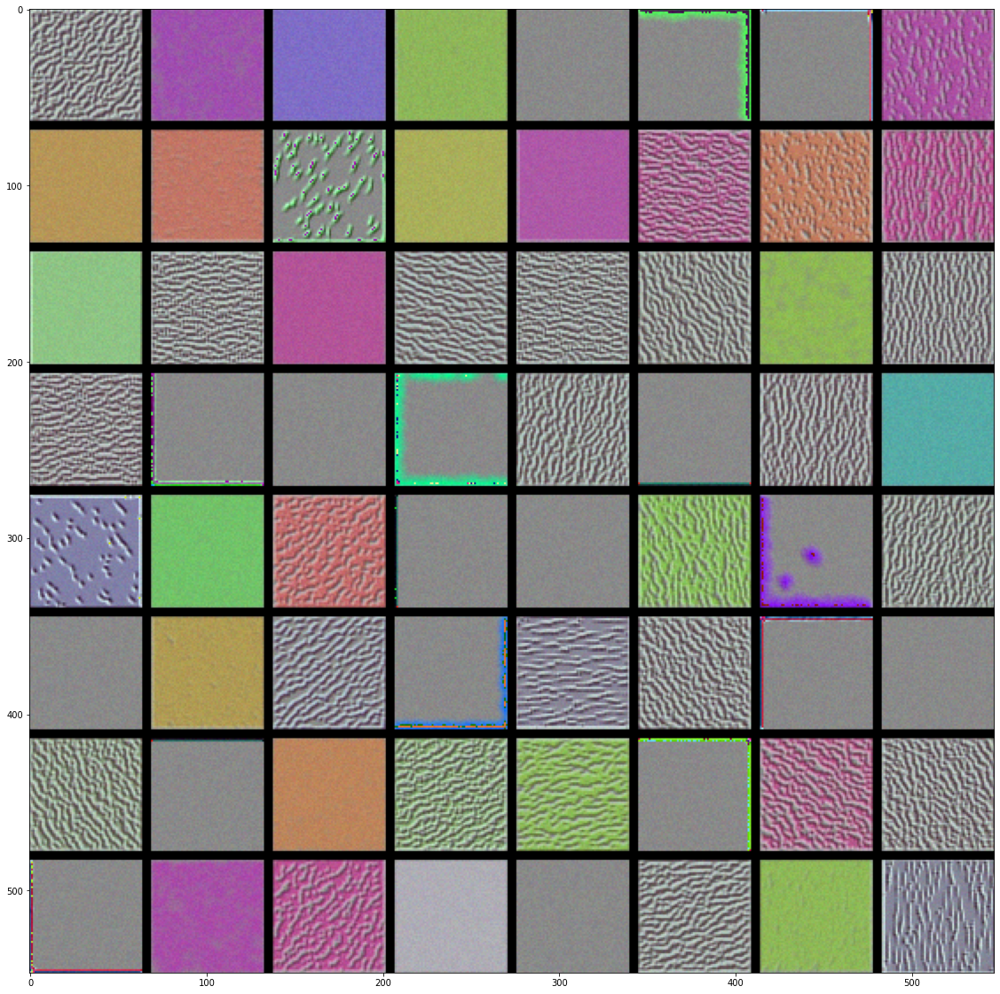

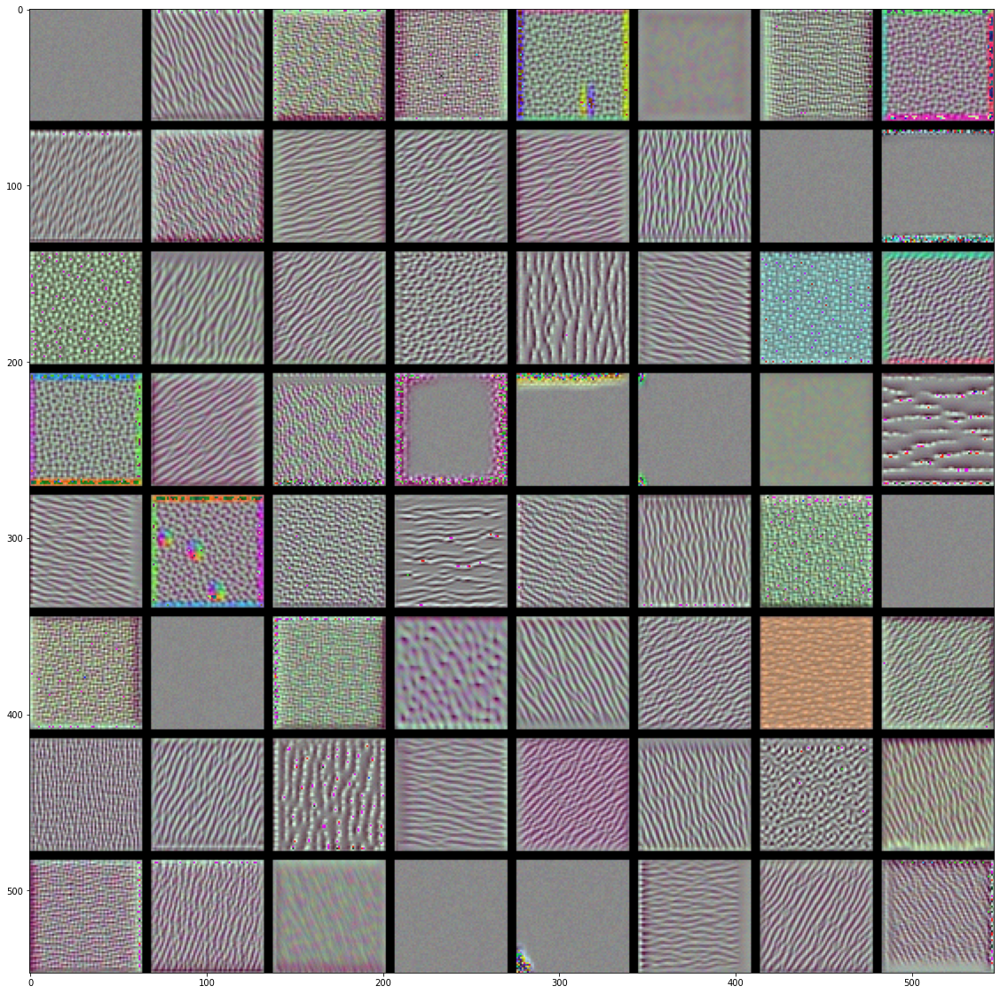

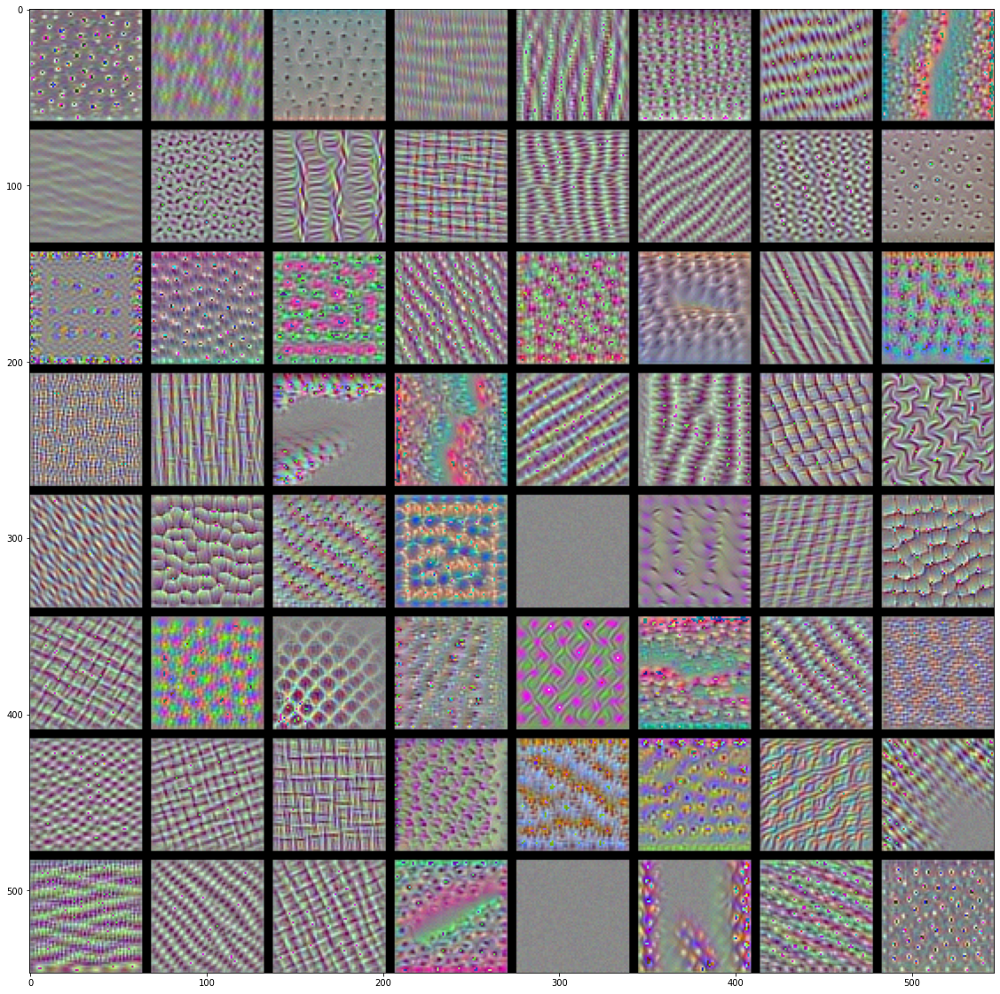

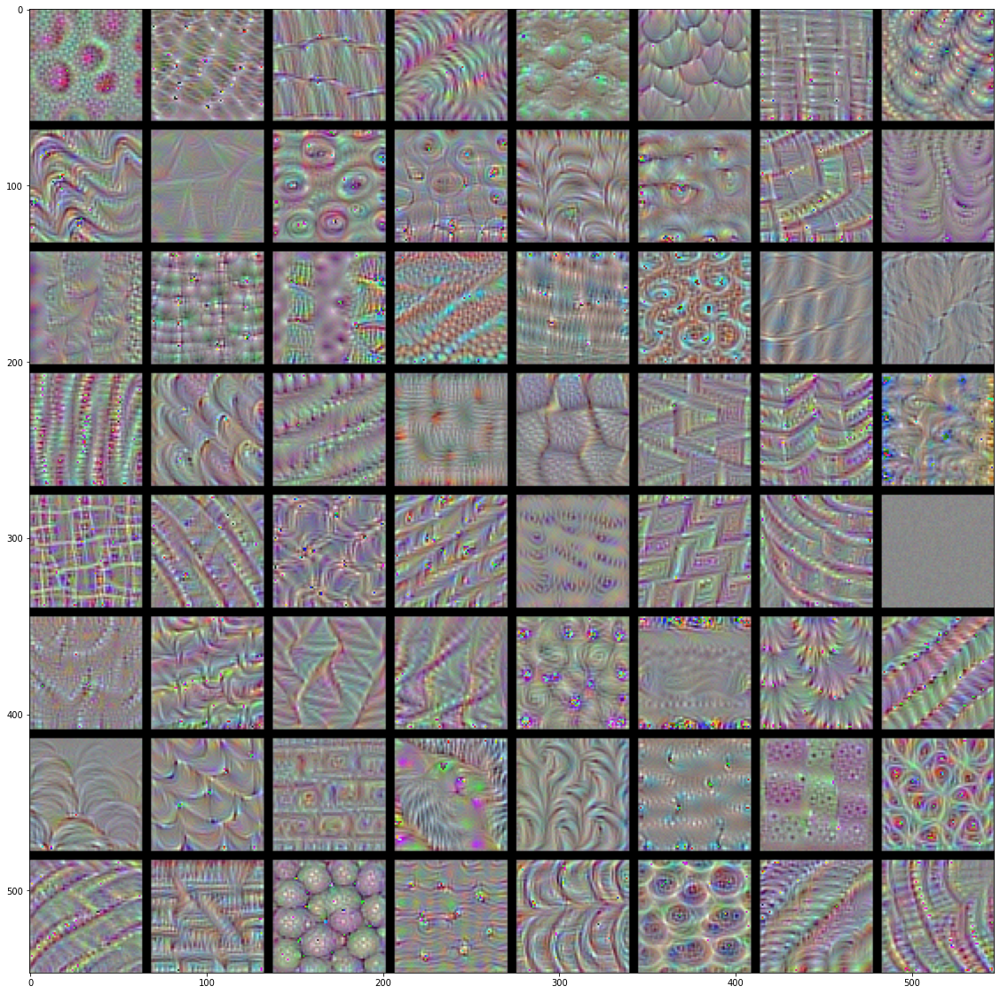

In [37]:
# Visualize the following 4 layers.

for layer_name in ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1']:
    size = 64
    margin = 5

    # This a empty (black) image where we will store our results.
    results = np.zeros((8 * size + 7 * margin, 8 * size + 7 * margin, 3)).astype(np.uint8)

    for i in range(8):  # iterate over the rows of our results grid
        for j in range(8):  # iterate over the columns of our results grid
            # Generate the pattern for filter `i + (j * 8)` in `layer_name`
            filter_img = generate_pattern(layer_name, i + (j * 8), size=size)

            # Put the result in the square `(i, j)` of the results grid
            horizontal_start = i * size + i * margin
            horizontal_end = horizontal_start + size
            vertical_start = j * size + j * margin
            vertical_end = vertical_start + size
            results[horizontal_start: horizontal_end, vertical_start: vertical_end, :] = filter_img

    # Display the results grid
    plt.figure(figsize=(20, 20))
    plt.imshow(results)
    plt.show()

These filter visualizations tell us a lot about how convnet layers see the world: each layer in a convnet simply learns a collection of filters such that their inputs can be expressed as a combination of the filters. This is similar to how the Fourier transform decomposes signals onto a bank of cosine functions. The filters in these convnet filter banks get increasingly complex and refined as we go higher-up in the model:

- The filters from the first layer in the model (block1_conv1) encode simple directional edges and colors (or colored edges in some cases).
- The filters from block2_conv1 encode simple textures made from combinations of edges and colors.
- The filters in higher-up layers start resembling textures found in natural images: feathers, eyes, leaves, etc.

## Visualizing heatmaps of class activation
Which parts of the image led a convnet to its final classification decision.

This general category of techniques is called `"Class Activation Map"` (CAM) visualization, and consists of producing heatmaps of "class activation" over input images. A `"class activation" heatmap` is a 2D grid of scores associated with an specific output class, computed for every location in any input image, indicating how important each location is with respect to the class considered. 

For instance, given an image fed into one of our "cat vs. dog" convnet, Class Activation Map visualization allows us to generate a heatmap for the class "cat", indicating how cat-like different parts of the image are, and likewise for the class "dog", indicating how dog-like different parts of the image are.

The specific implementation we will use is the one described in Grad-CAM: Why did you say that? Visual Explanations from Deep Networks via Gradient-based Localization. It is very simple: it consists in taking the output feature map of a convolution layer given an input image, and weighing every channel in that feature map by the gradient of the class with respect to the channel. Intuitively, one way to understand this trick is that we are weighting a spatial map of "how intensely the input image activates different channels" by "how important each channel is with regard to the class", resulting in a spatial map of "how intensely the input image activates the class".

In [11]:
from keras.applications.vgg16 import VGG16

K.clear_session()

# Note that we are including the densely-connected classifier on top;
# all previous times, we were discarding it.
model = VGG16(weights='imagenet')

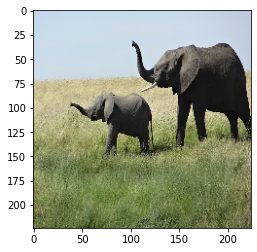

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


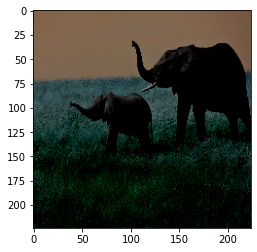

In [12]:
from keras.preprocessing import image
from keras.applications.vgg16 import preprocess_input, decode_predictions
import numpy as np

# The local path to our target image
img_path = 'creative_commons_elephant.jpg'

# `img` is a PIL image of size 224x224
img = image.load_img(img_path, target_size=(224, 224))

# `x` is a float32 Numpy array of shape (224, 224, 3)
x = image.img_to_array(img)

plt.imshow(x/255)
plt.show()

# We add a dimension to transform our array into a "batch"
# of size (1, 224, 224, 3)
x = np.expand_dims(x, axis=0)

# Finally we preprocess the batch
# (this does channel-wise color normalization)
x = preprocess_input(x)

input_img = x/255
plt.imshow(input_img[0])
plt.show()

In [13]:
preds = model.predict(x)
print('Predicted:', decode_predictions(preds,top=3)[0])

Predicted: [('n02504458', 'African_elephant', 0.90942115), ('n01871265', 'tusker', 0.08618289), ('n02504013', 'Indian_elephant', 0.004354583)]


The top-3 classes predicted for this image are:

- African elephant (with 91% probability)
- Tusker (with 8.6% probability)
- Indian elephant (with 0.4% probability)


### To visualize which parts of our image were the most "African elephant"-like, let's set up the Grad-CAM process:

In order to visualize which parts of the image are most "African elephant-like", we have to setup a Grad-CAM process. Tensorflow 2 allows to do that through automatic differentiation and what TensorFlow calls a gradient tape, which we have used also for the previous exercise about filter visualization.

Automatic differentiation is the process of computing a value and computing derivatives of that value.

TensorFlow 2 provides an implementation of automatic differentiation through what they call gradient tape:

*TensorFlow provides the tf.GradientTape API for automatic differentiation — computing the gradient of a computation with respect to its input variables. TensorFlow “records” all operations executed inside the context of a tf.GradientTape onto a “tape”. TensorFlow then uses that tape and the gradients associated with each recorded operation to compute the gradients of a “recorded” computation using reverse mode differentiation”.*

The gradients are calculated through automatic differentiation.


In [26]:
# This is the "african elephant" entry in the prediction vector
african_elephant_class_idx = np.argmax(preds[0])
african_elephant_output = model.output[:, african_elephant_class_idx]

# The is the output feature map of the `block5_conv3` layer,
# the last convolutional layer in VGG16
LAYER_NAME = 'block5_conv3'
last_conv_layer = model.get_layer(LAYER_NAME)

# This is the gradient of the "african elephant" class with regard to
# the output feature map of `block5_conv3`
import tensorflow as tf
grad_model = tf.keras.models.Model([model.inputs], [last_conv_layer.output, model.output])

with tf.GradientTape() as tape:
    conv_outputs, predictions = grad_model(x)
    loss = predictions[:, african_elephant_class_idx]

grads = tape.gradient(loss, conv_outputs)[0]

# This is a vector of shape (512,), where each entry is the mean intensity of the gradient over a specific feature map channel
weights = tf.reduce_mean(grads, axis=(0, 1, 2))

# We multiply each channel in the feature map array by "how important this channel is" with regard to the elephant class.
cam = tf.multiply(weights, conv_outputs[0])

# The channel-wise mean of the resulting feature map is our heatmap of class activation
heatmap = tf.reduce_mean(cam, axis=-1).numpy()

### Visualize the heatmap

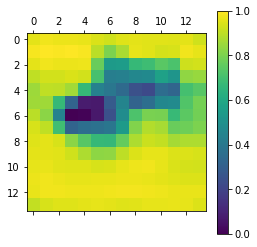

In [27]:
# Postprocessing heatmap
heatmap = (heatmap - np.min(heatmap)) / (heatmap.max() - heatmap.min())

plt.matshow(heatmap)
plt.colorbar()

### Superimposes the original image with the heatmap we just obtained

In [28]:
import cv2

# We use cv2 to load the original image
img = cv2.imread(img_path)

# We resize the heatmap to have the same size as the original image
heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))

# We convert the heatmap to RGB
heatmap = np.uint8(255 * heatmap)

# We apply the heatmap to the original image
heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

# 0.4 here is a heatmap intensity factor
superimposed_img = heatmap * 0.4 + img

# Save the image to disk
cv2.imwrite('elephant_cam.jpg', superimposed_img)

True

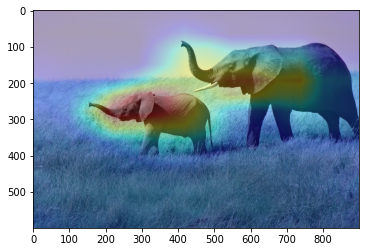

In [44]:
"""
It is interesting to note that the ears of the elephant cub are strongly activated: this is probably how the network can tell the difference between African and Indian elephants.
"""
plt.imshow(superimposed_img/np.max(superimposed_img))